# RCEL 506 Data Science Project on Asteroid Data from NASA

**Where to find the dataset**

This dataset is downloaded from Kaggle at this link:
https://www.kaggle.com/datasets/shrutimehta/nasa-asteroids-classification?resource=download&select=nasa.csv 


The NASA Jet Propulsion Laboratory Near Earth Object (NEO) program is the original owner of the dataset: http://neo.jpl.nasa.gov/


<img src="https://s.yimg.com/uu/api/res/1.2/L.imEId8_1YZXK776N0eZA--~B/aD02NzU7dz0xMDI4O2FwcGlkPXl0YWNoeW9u/https://o.aolcdn.com/images/dims3/GLOB/crop/3288x2156+333+218/resize/1028x675!/format/jpg/quality/85/http://o.aolcdn.com/hss/storage/midas/74600b90ca75f657c11b38c42ac0db95/0/a-swarm-of-asteroids-in-front-of-the-milky-way-galaxy-picture-id698529608" width=400>

**Data Visualization from NASA JPL Asteroid Watch**

https://www.jpl.nasa.gov/asteroid-watch/eyes-on-asteroids

# Research Topic, Hypothesis, and History
**Topic**

For this project I want to study
1. What Near Earth Objects (NEOs) are asteroids and which are comets
2. What comet and asteroid Near Earth Objects (NEOs) are Potentially Hazardous Objects (PHOs)
3. What Potentially Hazardous Objects (PHOs) look like graphically
4. What seasons does Earth experience the most Potentially Hazardous Objects (PHO) interactions 
    * can study this by looking at their close approach dates

**Hypothesis**

I hypothesize
1. There are more asteroid Near Earth Objects (NEOs)
2. There are more asteroid Near Earth Objects (NEO) that are also Potentially Hazardous Objects (PHOs)
3. The Semi-Major axis of a Potentially Hazardous Object (PHO) should decrease as it approaches the Sun and it's Orbital Speed (or Mean Motion) should increase as it approaches the Sun
4. Earth will experience the most Potentially Hazardous Object (PHO) interactions in the Fall months 
    * that's when we see the most showers
    * The Perseids and Leonids recur every Fall

**History**

Agencies like NASA track asteroids, not only because they might pose a threat to humanity by colliding with Earth, but because they can provide us with information about the history of our solar system, and even be useful for mining raw materials in space! A near-Earth object (NEO) is any small Solar System body whose orbit brings it into proximity with Earth. By convention, a Solar System body is a NEO if its closest approach to the Sun is less than 1.3 astronomical units (AU). If a NEO's orbit crosses the Earth's orbit, and the object is larger than 140 meters (460 ft) across, it is considered a potentially hazardous object (PHO). Most known PHOs and NEOs are asteroids, but a small fraction are comets. 

The Tisserand Parameter (or Jupiter Tisserand Invariant) is a measure of the orbital motion of a comet or asteroid with respect to a planet, usually Jupiter ($T_J$). For a small body with semi-major axis **a**, orbital eccentricity **e**, and orbital inclination **i**, relative to the orbit of a perturbing larger body with semimajor axis **$a_J$**, the parameter is defined as follows:

$$
T_J = \frac{a_j}{a} + 2 \cos(i) \sqrt{\frac{a}{a_J}(1-e^2)}
$$

The Tisserand parameter takes into account the semimajor axis, eccentricity, and inclination of the small body's orbit, and remains broadly constant during the small body's lifetime. It is a form of the restricted three-body problem and is useful in identifying small bodies observed before and after encounters with planets, as its numerical value remains largely unchanged by the encounter. The Tisserand parameter can also be used to classify planet-crossing bodies. Jupiter-family comets have Tisserand parameters between 2.0 and 3.0, and Halley-type and long-period comets have values less than 2.0. Asteroids generally have values greater than 3.0. However, there are both some periodic comets whose orbits have evolved to values greater than 3 and some asteroids with values less than 3. Many of the latter have been shown to be likely extinct or inactive comet nuclei. The parameter is named after the French astronomer François Félix Tisserand (1845–1896).

**To Summarize**
1. $T_J > 3$ are asteroids
2. $T_J < 3$ are comets
3. $T_J < 2$ are Halley-family comets
4. $2 < T_J < 3$ are Jupiter-family comets

For this project, I'll only be focusing on comets and asteroids in general. I will not be diving deep into the different comet families, this can be an option to further the project in the future.

# Literature Review

**Origin and Evolution of Near Earth Asteroids by A. Morbidelli**

* https://www.cambridge.org/core/journals/international-astronomical-union-colloquium/article/origin-and-evolution-of-near-earth-asteroids/92D813DF88D343249AB4B7B2ED4CBC35


**Comets in the near-Earth object population by Francesca DeMeo and Richard P. Binzel**

* https://www.sciencedirect.com/science/article/pii/S0019103507005258?casa_token=FLxJBL2mTwAAAAAA:GRiTLAYj2H67GUUZJbk0A60H6-sWyVXoboqT8_kVByVgmmFZi1azOJSAZaRVIslWgen4jcxG4A

**Potential impact detection for Near-Earth asteroids: the case of 99942 Apophis (2004 MN4)**
* https://www.cambridge.org/core/journals/proceedings-of-the-international-astronomical-union/article/potential-impact-detection-for-nearearth-asteroids-the-case-of-99942-apophis-2004-mn4/C22E1705065ED5E02D8CE6F89D68D3B1

# Import Modules

In [37]:
#these modules are necessary for the project
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# Importing the Data

In [38]:
#Read dataset (data comes in csv file)
original_nasa_df = pd.read_csv('nasa.csv')    #creating data frame of nasa.csv

#Show data
pd.set_option('display.max_columns', None)    #show max columns
original_nasa_df    #shows beginning/last rows in tableu

,Neo Reference ID,Name,Absolute Magnitude,Est Dia in KM(min),Est Dia in KM(max),Est Dia in M(min),Est Dia in M(max),Est Dia in Miles(min),Est Dia in Miles(max),Est Dia in Feet(min),Est Dia in Feet(max),Close Approach Date,Epoch Date Close Approach,Relative Velocity km per sec,Relative Velocity km per hr,Miles per hour,Miss Dist.(Astronomical),Miss Dist.(lunar),Miss Dist.(kilometers),Miss Dist.(miles),Orbiting Body,Orbit ID,Orbit Determination Date,Orbit Uncertainity,Minimum Orbit Intersection,Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Perihelion Time,Mean Anomaly,Mean Motion,Equinox,Hazardous
0,3703080,3703080,21.600,0.127220,0.284472,127.219879,284.472297,0.079051,0.176763,417.388066,933.308089,1995-01-01,788947200000,6.115834,22017.003799,13680.509944,0.419483,163.178711,6.275369e+07,3.899334e+07,Earth,17,2017-04-06 08:36:37,5,0.025282,4.634,2458000.5,0.425549,1.407011,6.025981,314.373913,609.599786,0.808259,57.257470,2.005764,2.458162e+06,264.837533,0.590551,J2000,True
1,3723955,3723955,21.300,0.146068,0.326618,146.067964,326.617897,0.090762,0.202951,479.225620,1071.581063,1995-01-01,788947200000,18.113985,65210.346095,40519.173105,0.383014,148.992630,5.729815e+07,3.560342e+07,Earth,21,2017-04-06 08:32:49,3,0.186935,5.457,2458000.5,0.351674,1.107776,28.412996,136.717242,425.869294,0.718200,313.091975,1.497352,2.457795e+06,173.741112,0.845330,J2000,False
2,2446862,2446862,20.300,0.231502,0.517654,231.502122,517.654482,0.143849,0.321655,759.521423,1698.341531,1995-01-08,789552000000,7.590711,27326.560182,16979.661798,0.050956,19.821890,7.622912e+06,4.736658e+06,Earth,22,2017-04-06 09:20:19,0,0.043058,4.557,2458000.5,0.348248,1.458824,4.237961,259.475979,643.580228,0.950791,248.415038,1.966857,2.458120e+06,292.893654,0.559371,J2000,True
3,3092506,3092506,27.400,0.008801,0.019681,8.801465,19.680675,0.005469,0.012229,28.876199,64.569144,1995-01-15,790156800000,11.173874,40225.948191,24994.839864,0.285322,110.990387,4.268362e+07,2.652237e+07,Earth,7,2017-04-06 09:15:49,6,0.005512,5.093,2458000.5,0.216578,1.255903,7.905894,57.173266,514.082140,0.983902,18.707701,1.527904,2.457902e+06,68.741007,0.700277,J2000,False
4,3514799,3514799,21.600,0.127220,0.284472,127.219879,284.472297,0.079051,0.176763,417.388066,933.308089,1995-01-15,790156800000,9.840831,35426.991794,22012.954985,0.407832,158.646713,6.101082e+07,3.791037e+07,Earth,25,2017-04-06 08:57:58,1,0.034798,5.154,2458000.5,0.210448,1.225615,16.793382,84.629307,495.597821,0.967687,158.263596,1.483543,2.457814e+06,135.142133,0.726395,J2000,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4682,3759007,3759007,23.900,0.044112,0.098637,44.111820,98.637028,0.027410,0.061290,144.723824,323.612307,2016-09-08,1473318000000,22.154265,79755.354273,49556.875548,0.041361,16.089413,6.187511e+06,3.844741e+06,Earth,4,2017-04-06 08:24:07,8,0.019777,5.156,2457637.5,0.361512,1.161429,39.880491,164.183305,457.179984,0.741558,276.395697,1.581299,2.457708e+06,304.306025,0.787436,J2000,False
4683,3759295,3759295,28.200,0.006089,0.013616,6.089126,13.615700,0.003784,0.008460,19.977449,44.670934,2016-09-08,1473318000000,3.225150,11610.539577,7214.337772,0.006469,2.516399,9.677324e+05,6.013211e+05,Earth,2,2017-04-06 08:23:58,6,0.006451,5.742,2458000.5,0.073200,1.075134,5.360249,345.225230,407.185767,0.996434,42.111064,1.153835,2.458088e+06,282.978786,0.884117,J2000,False
4684,3759714,3759714,22.700,0.076658,0.171412,76.657557,171.411509,0.047633,0.106510,251.501180,562.373736,2016-09-08,1473318000000,7.191642,25889.910626,16086.983633,0.061009,23.732393,9.126775e+06,5.671115e+06,Earth,17,2017-04-06 08:23:43,6,0.059972,4.410,2458000.5,0.368055,1.528234,4.405467,37.026468,690.054279,0.965760,274.692712,2.090708,2.458300e+06,203.501147,0.521698,J2000,False
4685,37597

# Cleaning the Data

NASA does a very good job of excluding NaN values in their datasets. Therefore, I only had to remove columns instead of rows. The columns I removed are unnecessary for my analysis.

**Original**

The original dataset has 4687 rows × 40 columns. The data types for the columns are: bool(1), float64(30), int64(5), object(4). The memory usage is 1.4+ MB.


**Cleaned**

The cleaned dataset has 4687 rows × 18 columns. The data types for the columns are: bool(1), float64(16), object(1). The memory usage is 627.2+ KB. 

In [39]:
#drop all unnecessary columns (can drop by column number instead of label) Note: remember python index starts at 0
cleaned_nasa_df = original_nasa_df.drop(columns=['Neo Reference ID','Name','Est Dia in KM(min)','Est Dia in M(min)','Est Dia in M(max)','Est Dia in Miles(min)','Est Dia in Miles(max)','Est Dia in Feet(min)','Est Dia in Feet(max)','Epoch Date Close Approach','Relative Velocity km per sec','Miles per hour','Miss Dist.(lunar)','Miss Dist.(kilometers)','Miss Dist.(miles)','Orbiting Body','Orbit ID','Orbit Determination Date','Orbit Uncertainity','Minimum Orbit Intersection','Perihelion Time','Equinox']) 

#show original and cleaned metadata
original_nasa_df.info()  #original metadata
print('---------------------------------------------------------------------')
cleaned_nasa_df.info()   #cleaned metadata

print('---------------------------------------------------------------------')

#Show cleaned dataset
pd.set_option('display.max_columns', None)  #show the max number of columns
cleaned_nasa_df    #shows beginning/last rows in tableu
#cleaned_nasa_df.isna().sum() #checking to make sure no NaN values exist (there are none)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4687 entries, 0 to 4686
Data columns (total 40 columns):
 #   Column                        Non-Null Count  Dtype  
---  ------                        --------------  -----  
 0   Neo Reference ID              4687 non-null   int64  
 1   Name                          4687 non-null   int64  
 2   Absolute Magnitude            4687 non-null   float64
 3   Est Dia in KM(min)            4687 non-null   float64
 4   Est Dia in KM(max)            4687 non-null   float64
 5   Est Dia in M(min)             4687 non-null   float64
 6   Est Dia in M(max)             4687 non-null   float64
 7   Est Dia in Miles(min)         4687 non-null   float64
 8   Est Dia in Miles(max)         4687 non-null   float64
 9   Est Dia in Feet(min)          4687 non-null   float64
 10  Est Dia in Feet(max)          4687 non-null   float64
 11  Close Approach Date           4687 non-null   object 
 12  Epoch Date Close Approach     4687 non-null   int64  
 13  Rel

,Absolute Magnitude,Est Dia in KM(max),Close Approach Date,Relative Velocity km per hr,Miss Dist.(Astronomical),Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Mean Anomaly,Mean Motion,Hazardous
0,21.600,0.284472,1995-01-01,22017.003799,0.419483,4.634,2458000.5,0.425549,1.407011,6.025981,314.373913,609.599786,0.808259,57.257470,2.005764,264.837533,0.590551,True
1,21.300,0.326618,1995-01-01,65210.346095,0.383014,5.457,2458000.5,0.351674,1.107776,28.412996,136.717242,425.869294,0.718200,313.091975,1.497352,173.741112,0.845330,False
2,20.300,0.517654,1995-01-08,27326.560182,0.050956,4.557,2458000.5,0.348248,1.458824,4.237961,259.475979,643.580228,0.950791,248.415038,1.966857,292.893654,0.559371,True
3,27.400,0.019681,1995-01-15,40225.948191,0.285322,5.093,2458000.5,0.216578,1.255903,7.905894,57.173266,514.082140,0.983902,18.707701,1.527904,68.741007,0.700277,False
4,21.600,0.284472,1995-01-15,35426.991794,0.407832,5.154,2458000.5,0.210448,1.225615,16.793382,84.629307,495.597821,0.967687,158.263596,1.483543,135.142133,0.726395,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4682,23.900,0.098637,2016-09-08,79755.354273,0.041361,5.156,2457637.5,0.361512,1.161429,39.880491,164.183305,457.179984,0.741558,276.395697,1.581299,304.306025,0.787436,False
4683,28.200,0.013616,2016-09-08,11610.539577,0.006469,5.742,2458000.5,0.073200,1.075134,5.360249,345.225230,407.185767,0.996434,42.111064,1.153835,282.978786,0.884117,False
4684,22.700,0.171412,2016-09-08,25889.910626,0.061009,4.410,2458000.5,0.368055,1.528234,4.405467,37.026468,690.054279,0.965760,274.692712,2.090708,203.501147,0.521698,False
4685,21.800,0.259442,2016-09-08,40867.522309,0.260760,4.477,2458000.5,0.202565,1.486600,21.080244,163.802910,662.048343,1.185467,180.346090,1.787733,203.524965,0.543767,False


# Statistical Analysis

Identify all the statistical measures of the cleaned dataset

In [40]:
#printing out some descriptions of the data
print('The description of the dataset is:')
display(cleaned_nasa_df.describe())  #makes a nice table
print('---------------------------------------------------------------------')
print('The Median of the cleaned dataset is:\n',cleaned_nasa_df.median())          #displaying median of cleaned_nasa_df
print('---------------------------------------------------------------------')
print('The Variance of the cleaned dataset is:\n',cleaned_nasa_df.var())           #displaying variance of cleaned_nasa_df

The description of the dataset is:


,Absolute Magnitude,Est Dia in KM(max),Relative Velocity km per hr,Miss Dist.(Astronomical),Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Mean Anomaly,Mean Motion
count,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4.687000e+03,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000,4687.000000
mean,22.267865,0.457509,50294.919829,0.256778,5.056111,2.457724e+06,0.382569,1.400264,13.373844,172.157275,635.582076,0.813383,183.932151,1.987144,181.167927,0.738242
std,2.890972,0.826391,26255.601377,0.145798,1.237818,9.202975e+02,0.180444,0.524154,10.936227,103.276777,370.954727,0.242059,103.513035,0.951519,107.501623,0.342627
min,11.160000,0.002260,1207.814804,0.000178,2.196000,2.450164e+06,0.007522,0.615920,0.014513,0.001941,176.557161,0.080744,0.006918,0.803765,0.003191,0.086285
25%,20.100000,0.074824,30358.313370,0.133420,4.049500,2.458000e+06,0.240858,1.000635,4.962341,83.081208,365.605031,0.630834,95.625916,1.266059,87.006918,0.453289
50%,21.900000,0.247765,46504.401181,0.265029,5.071000,2.458000e+06,0.372450,1.240981,10.311836,172.625393,504.947292,0.833153,189.761641,1.618195,185.718889,0.712946
75%,24.500000,0.567597,65079.535405,0.384154,6.019000,2.458000e+06,0.512411,1.678364,19.511681,255.026909,794.195972,0.997227,271.777557,2.451171,276.531946,0.984669
max,32.100000,34.836938,160681.487851,0.499884,9.025000,2.458020e+06,0.960261,5.072008,75.406667,359.905890,4172.231343,1.299832,359.993098,8.983852,359.917991,2.039000


---------------------------------------------------------------------
The Median of the cleaned dataset is:
 Absolute Magnitude             2.190000e+01
Est Dia in KM(max)             2.477650e-01
Relative Velocity km per hr    4.650440e+04
Miss Dist.(Astronomical)       2.650286e-01
Jupiter Tisserand Invariant    5.071000e+00
Epoch Osculation               2.458000e+06
Eccentricity                   3.724502e-01
Semi Major Axis                1.240981e+00
Inclination                    1.031184e+01
Asc Node Longitude             1.726254e+02
Orbital Period                 5.049473e+02
Perihelion Distance            8.331526e-01
Perihelion Arg                 1.897616e+02
Aphelion Dist                  1.618195e+00
Mean Anomaly                   1.857189e+02
Mean Motion                    7.129457e-01
Hazardous                      0.000000e+00
dtype: float64
---------------------------------------------------------------------
The Variance of the cleaned dataset is:
 Absolute Magnitud

C:\Users\kiara\AppData\Local\Temp\ipykernel_10848\3851527652.py:5: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.

C:\Users\kiara\AppData\Local\Temp\ipykernel_10848\3851527652.py:7: FutureWarning:

Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.



#### Correlation & Colinearity
* weak correlation - below 0.25
* moderate correlation - between 0.25 to 0.75
* strong correlation - between 0.75 to 1

* correlation is connecting x to y
* colinearity is connecting x to x or y to y (0 to 0.5)

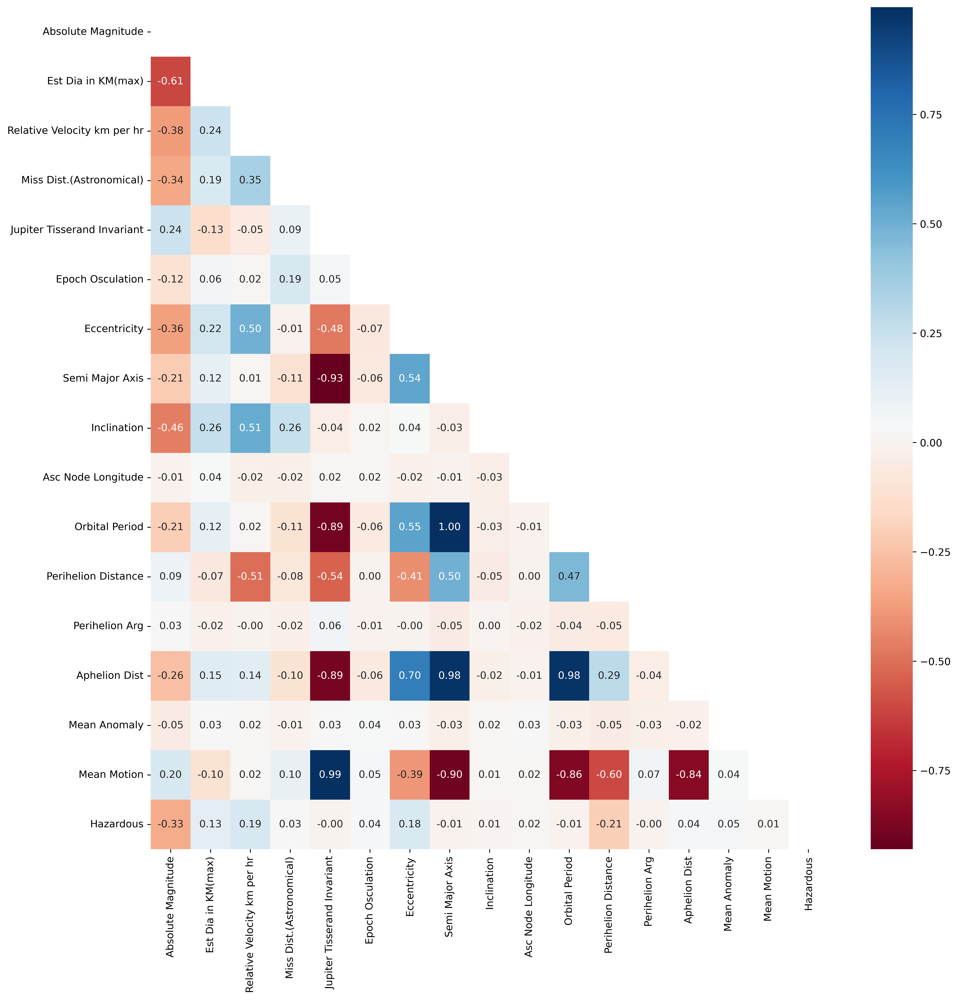

In [41]:
#finding correlation in the variables
fig = plt.figure(figsize = (15,15), dpi = 480) #dpi: set the resolution of the figure in dots-per-inch
sns.heatmap(cleaned_nasa_df.corr(), #compute correlation of data frame
            cmap = 'RdBu',  #changing color to red and blue
            annot = True,   #write the data value in each cell if annot = true
            fmt = '.2f',    #no scientific notation and use 2 floating point numbers instead
            mask = np.triu(cleaned_nasa_df.corr())) #only keeping lower triangle since matrix is symmetric
plt.show()

#### Pandas Profiling

In [42]:
#install pandas proifiling
!pip install pandas-profiling[notebook]

In [43]:
from ydata_profiling import ProfileReport
profile = ProfileReport(cleaned_nasa_df, title = "Profiling Report")
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# Results - Part 1 and Part 2

**Topic 1** - What Near Earth Objects (NEOs) are asteroids and which are comets

**Hypothesis 1** - There are more asteroid Near Earth Objects (NEOs)

**Topic 2** - What comet and asteroid Near Earth Objects (NEOs) are Potentially Hazardous Objects (PHOs)

**Hypothesis 2** - There are more asteroid Near Earth Objects (NEO) that are also Potentially Hazardous Objects (PHOs)

---------------------------------------------------------------------------------------------------------------------------

Creating 8 dataframes to measure how many comets, asteroids, hazardous, and nonhazardous objects there are.

* Comets - The new data frame for the comets is 118 rows × 18 columns, meaning there are 118 comet-like objects in this dataset.

* Asteroids - The new data frame for the asteroids is 4569 rows × 18 columns, meaning there are 4569 asteroid-like objects in this dataset.

* Hazardous - The new data frame for the Hazardous objects is 755 rows × 17 columns, meaning there are 755 hazardous objects in this dataset.

* non-Hazardous - The new data frame for the nonHazardous objects is 3932 rows × 17 columns, meaning there are 3932 nonhazardous objects in this dataset.

---------------------------------------------------------------------------------------------------------------------------

* Hazardous asteroids - The new data frame for the Hazardous asteroids is 731 rows × 18 columns, meaning there are 731 hazardous asteroids in this dataset.

* non-Hazardous asteroids - The new data frame for the nonHazardous asteroids is 3838 rows × 18 columns, meaning there are 3838 nonhazardous asteroids in this dataset.

* Hazardous comets - The new data frame for the Hazardous comets is 22 rows × 18 columns, meaning there are 22 hazardous comets in this dataset.

* non-Hazardous comets - The new data frame for the nonHazardous comets is 94 rows × 18 columns, meaning there are 94 nonhazardous comets in this dataset.

---------------------------------------------------------------------------------------------------------------------------

**Results - Part 1**

My hypothesis was correct
* There are 118 comets in the dataset
* There are 4569 asteroids in the dataset

**Results - Part 2**

My hypothesis was correct
* There are 731 hazardous asteroids in this dataset
* There are 22 hazardous comets in this dataset

In [44]:
#categorizing asteroids
cleaned_nasa_asteroids_df = cleaned_nasa_df[cleaned_nasa_df['Jupiter Tisserand Invariant'] > 3]  #only keeping > 3 values
cleaned_nasa_asteroids_df.reset_index(inplace = True,drop = True)                                #reseting index values
print('The asteroids in the dataset are:')
display(cleaned_nasa_asteroids_df)

#categorizing comets
cleaned_nasa_comets_df = cleaned_nasa_df[cleaned_nasa_df['Jupiter Tisserand Invariant'] < 3]     #only keeping < 3 values
cleaned_nasa_comets_df.reset_index(inplace = True,drop = True)                                   #reseting index values
print('The comets in the dataset are:')
display(cleaned_nasa_comets_df)

#categorizing hazardous objects
hazardous_grouped_df = cleaned_nasa_df.groupby(cleaned_nasa_df.Hazardous)      #grouping hazardous column
hazardous_df = hazardous_grouped_df.get_group(True)                            #keeping true values from hazardous column
hazardous_df.reset_index(inplace = True,drop = True)                           #reseting index values
print('The Hazardous object dataset is:')
display(hazardous_df)

#categorizing non-hazardous objects
nonhazardous_grouped_df = cleaned_nasa_df.groupby(cleaned_nasa_df.Hazardous)   #grouping nonhazardous column
nonhazardous_df = nonhazardous_grouped_df.get_group(False)                     #keeping false values from hazardous column
nonhazardous_df.reset_index(inplace = True,drop = True)                        #reseting index values
print('The nonHazardous object dataset is:')
display(nonhazardous_df)

##############################################################################################################################

#categorizing asteroids that are hazardous
hazardous_asteroids_grouped_df = cleaned_nasa_asteroids_df.groupby(cleaned_nasa_asteroids_df.Hazardous)
hazardous_asteroids_df = hazardous_asteroids_grouped_df.get_group(True)
hazardous_asteroids_df.reset_index(inplace = True,drop = True)                           
print('The Hazardous asteroid dataset is:')
display(hazardous_asteroids_df)

#categorizing asteroids that are nonhazardous
nonhazardous_asteroids_grouped_df = cleaned_nasa_asteroids_df.groupby(cleaned_nasa_asteroids_df.Hazardous)
nonhazardous_asteroids_df = nonhazardous_asteroids_grouped_df.get_group(False)
nonhazardous_asteroids_df.reset_index(inplace = True,drop = True)                           
print('The nonHazardous asteroid dataset is:')
display(nonhazardous_asteroids_df)

#categorizing comets that are hazardous
hazardous_comets_grouped_df = cleaned_nasa_comets_df.groupby(cleaned_nasa_comets_df.Hazardous)
hazardous_comets_df = hazardous_comets_grouped_df.get_group(True)
hazardous_comets_df.reset_index(inplace = True,drop = True)                           
print('The Hazardous comet dataset is:')
display(hazardous_comets_df)

#categorizing comets that are nonhazardous
nonhazardous_comets_grouped_df = cleaned_nasa_comets_df.groupby(cleaned_nasa_comets_df.Hazardous)
nonhazardous_comets_df = nonhazardous_comets_grouped_df.get_group(False)
nonhazardous_comets_df.reset_index(inplace = True,drop = True)                           
print('The nonHazardous comet dataset is:')
display(nonhazardous_comets_df)

The asteroids in the dataset are:


,Absolute Magnitude,Est Dia in KM(max),Close Approach Date,Relative Velocity km per hr,Miss Dist.(Astronomical),Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Mean Anomaly,Mean Motion,Hazardous
0,21.600,0.284472,1995-01-01,22017.003799,0.419483,4.634,2458000.5,0.425549,1.407011,6.025981,314.373913,609.599786,0.808259,57.257470,2.005764,264.837533,0.590551,True
1,21.300,0.326618,1995-01-01,65210.346095,0.383014,5.457,2458000.5,0.351674,1.107776,28.412996,136.717242,425.869294,0.718200,313.091975,1.497352,173.741112,0.845330,False
2,20.300,0.517654,1995-01-08,27326.560182,0.050956,4.557,2458000.5,0.348248,1.458824,4.237961,259.475979,643.580228,0.950791,248.415038,1.966857,292.893654,0.559371,True
3,27.400,0.019681,1995-01-15,40225.948191,0.285322,5.093,2458000.5,0.216578,1.255903,7.905894,57.173266,514.082140,0.983902,18.707701,1.527904,68.741007,0.700277,False
4,21.600,0.284472,1995-01-15,35426.991794,0.407832,5.154,2458000.5,0.210448,1.225615,16.793382,84.629307,495.597821,0.967687,158.263596,1.483543,135.142133,0.726395,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4564,23.900,0.098637,2016-09-08,79755.354273,0.041361,5.156,2457637.5,0.361512,1.161429,39.880491,164.183305,457.179984,0.741558,276.395697,1.581299,304.306025,0.787436,False
4565,28.200,0.013616,2016-09-08,11610.539577,0.006469,5.742,2458000.5,0.073200,1.075134,5.360249,345.225230,407.185767,0.996434,42.111064,1.153835,282.978786,0.884117,False
4566,22.700,0.171412,2016-09-08,25889.910626,0.061009,4.410,2458000.5,0.368055,1.528234,4.405467,37.026468,690.054279,0.965760,274.692712,2.090708,203.501147,0.521698,False
4567,21.800,0.259442,2016-09-08,40867.522309,0.260760,4.477,2458000.5,0.202565,1.486600,21.080244,163.802910,662.048343,1.185467,180.346090,1.787733,203.524965,0.543767,False


The comets in the dataset are:


,Absolute Magnitude,Est Dia in KM(max),Close Approach Date,Relative Velocity km per hr,Miss Dist.(Astronomical),Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Mean Anomaly,Mean Motion,Hazardous
0,18.2,1.361570,1995-09-08,49106.937719,0.175812,2.929,2458000.5,0.586624,2.857747,22.632136,342.212426,1764.550426,1.181324,14.052570,4.534170,204.642729,0.204018,False
1,21.2,0.342011,1995-09-22,118849.444447,0.428792,2.976,2458000.5,0.742920,2.535083,8.947768,344.161592,1474.303194,0.651720,118.259534,4.418447,149.774654,0.244183,True
2,18.3,1.300289,1995-12-08,69480.538632,0.397148,2.710,2458000.5,0.675887,3.238893,18.473842,230.827240,2129.086675,1.049768,173.863021,5.428019,256.995331,0.169087,False
3,19.7,0.682402,1996-02-22,101257.092037,0.319600,2.949,2458000.5,0.743861,2.507453,19.651526,101.105035,1450.266196,0.642256,327.417444,4.372651,157.717883,0.248230,False
4,18.3,1.300289,1996-06-08,79002.171980,0.191414,2.962,2458000.5,0.702387,2.672460,5.852198,13.860048,1595.751020,0.795358,319.815769,4.549561,314.107896,0.225599,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
113,24.5,0.074824,2016-02-22,35413.581797,0.108532,2.930,2458000.5,0.641365,2.916230,4.006154,314.636917,1818.993593,1.045863,220.074920,4.786597,107.777115,0.197912,False
114,18.2,1.361570,2016-03-08,153789.175968,0.259758,2.367,2458000.5,0.608225,2.489714,75.406667,179.380018,1434.902951,0.975408,357.820027,4.004020,138.526757,0.250888,True
115,21.9,0.247765,2016-03-15,40565.167078,0.275687,2.477,2458000.5,0.726906,3.990838,12.738002,304.592814,2912.022020,1.089874,217.275700,6.891803,66.685647,0.123625,False
116,21.6,0.284472,2016-03-15,39407.078650,0.430182,2.996,2458000.5,0.637792,2.602590,23.821204,45.586718,1533.581836,0.942679,73.913897,4.262500,139.434064,0.234745,False


The Hazardous object dataset is:


,Absolute Magnitude,Est Dia in KM(max),Close Approach Date,Relative Velocity km per hr,Miss Dist.(Astronomical),Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Mean Anomaly,Mean Motion,Hazardous
0,21.6,0.284472,1995-01-01,22017.003799,0.419483,4.634,2458000.5,0.425549,1.407011,6.025981,314.373913,609.599786,0.808259,57.257470,2.005764,264.837533,0.590551,True
1,20.3,0.517654,1995-01-08,27326.560182,0.050956,4.557,2458000.5,0.348248,1.458824,4.237961,259.475979,643.580228,0.950791,248.415038,1.966857,292.893654,0.559371,True
2,21.6,0.284472,1995-01-15,35426.991794,0.407832,5.154,2458000.5,0.210448,1.225615,16.793382,84.629307,495.597821,0.967687,158.263596,1.483543,135.142133,0.726395,True
3,21.5,0.297879,1995-01-22,46438.594999,0.151806,6.623,2458000.5,0.551389,0.876125,2.059577,2.613682,299.535161,0.393040,253.765937,1.359211,119.861382,1.201862,True
4,21.7,0.271669,1995-02-22,102308.235340,0.048541,6.152,2453548.5,0.868419,0.906734,4.035074,342.784208,315.368341,0.119309,322.390496,1.694158,303.979299,1.141522,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
750,19.3,0.820427,2016-08-08,83037.453644,0.058309,3.921,2458000.5,0.574790,1.647586,34.116306,138.565536,772.450559,0.700571,100.270236,2.594602,205.762131,0.466049,True
751,21.5,0.297879,2016-08-08,53116.160437,0.120808,5.786,2458000.5,0.095001,1.037464,29.922212,136.762870,385.973723,0.938903,39.290250,1.136024,142.264753,0.932706,True
752,20.2,0.542051,2016-08-15,45440.631184,0.189567,4.304,2458000.5,0.376807,1.573764,11.682160,169.500723,721.120395,0.980758,196.948416,2.166770,177.326778,0.499223,True
753,21.6,0.284472,2016-08-15,61757.130145,0.390278,4.478,2458000.5,0.562406,1.439534,7.159010,54.443592,630.857755,0.629932,256.055109,2.249136,223.131665,0.570652,True


The nonHazardous object dataset is:


,Absolute Magnitude,Est Dia in KM(max),Close Approach Date,Relative Velocity km per hr,Miss Dist.(Astronomical),Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Mean Anomaly,Mean Motion,Hazardous
0,21.300,0.326618,1995-01-01,65210.346095,0.383014,5.457,2458000.5,0.351674,1.107776,28.412996,136.717242,425.869294,0.718200,313.091975,1.497352,173.741112,0.845330,False
1,27.400,0.019681,1995-01-15,40225.948191,0.285322,5.093,2458000.5,0.216578,1.255903,7.905894,57.173266,514.082140,0.983902,18.707701,1.527904,68.741007,0.700277,False
2,19.600,0.714562,1995-01-15,38911.838251,0.392785,4.724,2458000.5,0.563441,1.323532,17.927751,178.971951,556.160556,0.577800,198.145969,2.069265,354.237368,0.647295,False
3,19.600,0.714562,1995-01-15,38911.829716,0.392783,4.724,2458000.5,0.563441,1.323532,17.927748,178.971953,556.160544,0.577800,198.145960,2.069265,354.237396,0.647295,False
4,19.200,0.859093,1995-01-22,87918.782382,0.129179,4.921,2458000.5,0.449763,1.237475,34.695127,112.562984,502.808758,0.680905,288.374651,1.794045,186.776932,0.715978,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3927,23.900,0.098637,2016-09-08,79755.354273,0.041361,5.156,2457637.5,0.361512,1.161429,39.880491,164.183305,457.179984,0.741558,276.395697,1.581299,304.306025,0.787436,False
3928,28.200,0.013616,2016-09-08,11610.539577,0.006469,5.742,2458000.5,0.073200,1.075134,5.360249,345.225230,407.185767,0.996434,42.111064,1.153835,282.978786,0.884117,False
3929,22.700,0.171412,2016-09-08,25889.910626,0.061009,4.410,2458000.5,0.368055,1.528234,4.405467,37.026468,690.054279,0.965760,274.692712,2.090708,203.501147,0.521698,False
3930,21.800,0.259442,2016-09-08,40867.522309,0.260760,4.477,2458000.5,0.202565,1.486600,21.080244,163.802910,662.048343,1.185467,180.346090,1.787733,203.524965,0.543767,False


The Hazardous asteroid dataset is:


,Absolute Magnitude,Est Dia in KM(max),Close Approach Date,Relative Velocity km per hr,Miss Dist.(Astronomical),Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Mean Anomaly,Mean Motion,Hazardous
0,21.6,0.284472,1995-01-01,22017.003799,0.419483,4.634,2458000.5,0.425549,1.407011,6.025981,314.373913,609.599786,0.808259,57.257470,2.005764,264.837533,0.590551,True
1,20.3,0.517654,1995-01-08,27326.560182,0.050956,4.557,2458000.5,0.348248,1.458824,4.237961,259.475979,643.580228,0.950791,248.415038,1.966857,292.893654,0.559371,True
2,21.6,0.284472,1995-01-15,35426.991794,0.407832,5.154,2458000.5,0.210448,1.225615,16.793382,84.629307,495.597821,0.967687,158.263596,1.483543,135.142133,0.726395,True
3,21.5,0.297879,1995-01-22,46438.594999,0.151806,6.623,2458000.5,0.551389,0.876125,2.059577,2.613682,299.535161,0.393040,253.765937,1.359211,119.861382,1.201862,True
4,21.7,0.271669,1995-02-22,102308.235340,0.048541,6.152,2453548.5,0.868419,0.906734,4.035074,342.784208,315.368341,0.119309,322.390496,1.694158,303.979299,1.141522,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,19.3,0.820427,2016-08-08,83037.453644,0.058309,3.921,2458000.5,0.574790,1.647586,34.116306,138.565536,772.450559,0.700571,100.270236,2.594602,205.762131,0.466049,True
727,21.5,0.297879,2016-08-08,53116.160437,0.120808,5.786,2458000.5,0.095001,1.037464,29.922212,136.762870,385.973723,0.938903,39.290250,1.136024,142.264753,0.932706,True
728,20.2,0.542051,2016-08-15,45440.631184,0.189567,4.304,2458000.5,0.376807,1.573764,11.682160,169.500723,721.120395,0.980758,196.948416,2.166770,177.326778,0.499223,True
729,21.6,0.284472,2016-08-15,61757.130145,0.390278,4.478,2458000.5,0.562406,1.439534,7.159010,54.443592,630.857755,0.629932,256.055109,2.249136,223.131665,0.570652,True


The nonHazardous asteroid dataset is:


,Absolute Magnitude,Est Dia in KM(max),Close Approach Date,Relative Velocity km per hr,Miss Dist.(Astronomical),Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Mean Anomaly,Mean Motion,Hazardous
0,21.300,0.326618,1995-01-01,65210.346095,0.383014,5.457,2458000.5,0.351674,1.107776,28.412996,136.717242,425.869294,0.718200,313.091975,1.497352,173.741112,0.845330,False
1,27.400,0.019681,1995-01-15,40225.948191,0.285322,5.093,2458000.5,0.216578,1.255903,7.905894,57.173266,514.082140,0.983902,18.707701,1.527904,68.741007,0.700277,False
2,19.600,0.714562,1995-01-15,38911.838251,0.392785,4.724,2458000.5,0.563441,1.323532,17.927751,178.971951,556.160556,0.577800,198.145969,2.069265,354.237368,0.647295,False
3,19.600,0.714562,1995-01-15,38911.829716,0.392783,4.724,2458000.5,0.563441,1.323532,17.927748,178.971953,556.160544,0.577800,198.145960,2.069265,354.237396,0.647295,False
4,19.200,0.859093,1995-01-22,87918.782382,0.129179,4.921,2458000.5,0.449763,1.237475,34.695127,112.562984,502.808758,0.680905,288.374651,1.794045,186.776932,0.715978,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3833,23.900,0.098637,2016-09-08,79755.354273,0.041361,5.156,2457637.5,0.361512,1.161429,39.880491,164.183305,457.179984,0.741558,276.395697,1.581299,304.306025,0.787436,False
3834,28.200,0.013616,2016-09-08,11610.539577,0.006469,5.742,2458000.5,0.073200,1.075134,5.360249,345.225230,407.185767,0.996434,42.111064,1.153835,282.978786,0.884117,False
3835,22.700,0.171412,2016-09-08,25889.910626,0.061009,4.410,2458000.5,0.368055,1.528234,4.405467,37.026468,690.054279,0.965760,274.692712,2.090708,203.501147,0.521698,False
3836,21.800,0.259442,2016-09-08,40867.522309,0.260760,4.477,2458000.5,0.202565,1.486600,21.080244,163.802910,662.048343,1.185467,180.346090,1.787733,203.524965,0.543767,False


The Hazardous comet dataset is:


,Absolute Magnitude,Est Dia in KM(max),Close Approach Date,Relative Velocity km per hr,Miss Dist.(Astronomical),Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Mean Anomaly,Mean Motion,Hazardous
0,21.2,0.342011,1995-09-22,118849.444447,0.428792,2.976,2458000.5,0.742920,2.535083,8.947768,344.161592,1474.303194,0.651720,118.259534,4.418447,149.774654,0.244183,True
1,18.3,1.300289,1996-06-08,79002.171980,0.191414,2.962,2458000.5,0.702387,2.672460,5.852198,13.860048,1595.751020,0.795358,319.815769,4.549561,314.107896,0.225599,True
2,21.1,0.358129,1996-08-08,92787.819344,0.046488,2.753,2458000.5,0.819252,2.651713,15.020224,126.778872,1577.204947,0.479292,289.259931,4.824133,310.976922,0.228252,True
3,21.3,0.326618,1999-04-15,91730.526338,0.215250,2.933,2458000.5,0.688874,2.626090,22.456259,35.969525,1554.400365,0.817044,238.326758,4.435136,105.998114,0.231601,True
4,18.0,1.492932,1999-04-22,131337.227262,0.047900,2.943,2458000.5,0.664500,2.117351,59.379202,33.605726,1125.349950,0.710371,251.101810,3.524330,333.457793,0.319900,True
5,20.4,0.494356,1999-07-22,97634.768489,0.308697,2.968,2458000.5,0.712265,2.625573,8.621482,285.551518,1553.941552,0.755470,287.321323,4.495677,102.641980,0.231669,True
6,19.3,0.820427,2001-01-15,82764.190415,0.290819,2.978,2458000.5,0.654553,2.404100,37.683934,133.042396,1361.530328,0.830490,316.324510,3.977711,173.047863,0.264408,True
7,21.1,0.358129,2001-07-08,64035.769781,0.359285,2.907,2458000.5,0.744335,2.635714,11.016894,178.028592,1562.952416,0.673859,92.292936,4.597568,277.717287,0.230333,True
8,19.4,0.783502,2002-05-15,81913.831050,0.145828,2.607,2458000.5,0.681327,3.234045,30.108839,144.876011,2124.308533,1.030602,174.416280,5.437489,345.162724,0.169467,True
9,19.0,0.941976,2003-12-22,128314.039921,0.381349,2.732,2458000.5,0.770621,2.752302,24.819218,286.212490,1667.794600,0.631319,262.270689,4.873285,350.868981,0.215854,True


The nonHazardous comet dataset is:


,Absolute Magnitude,Est Dia in KM(max),Close Approach Date,Relative Velocity km per hr,Miss Dist.(Astronomical),Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Mean Anomaly,Mean Motion,Hazardous
0,18.2,1.361570,1995-09-08,49106.937719,0.175812,2.929,2458000.5,0.586624,2.857747,22.632136,342.212426,1764.550426,1.181324,14.052570,4.534170,204.642729,0.204018,False
1,18.3,1.300289,1995-12-08,69480.538632,0.397148,2.710,2458000.5,0.675887,3.238893,18.473842,230.827240,2129.086675,1.049768,173.863021,5.428019,256.995331,0.169087,False
2,19.7,0.682402,1996-02-22,101257.092037,0.319600,2.949,2458000.5,0.743861,2.507453,19.651526,101.105035,1450.266196,0.642256,327.417444,4.372651,157.717883,0.248230,False
3,18.7,1.081534,1996-09-15,38365.930809,0.367329,2.896,2458000.5,0.595422,3.020927,16.587733,157.177166,1917.824571,1.222201,208.846768,4.819654,337.254951,0.187713,False
4,17.5,1.879490,1996-10-22,88307.645067,0.320134,2.808,2458000.5,0.592562,2.688138,41.083705,37.887162,1609.813928,1.095248,296.564204,4.281027,278.240244,0.223628,False
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
89,21.6,0.284472,2016-02-22,60384.934105,0.215869,2.748,2458000.5,0.642047,3.035437,27.987354,140.776882,1931.657916,1.086545,43.699740,4.984329,98.072520,0.186368,False
90,24.5,0.074824,2016-02-22,35413.581797,0.108532,2.930,2458000.5,0.641365,2.916230,4.006154,314.636917,1818.993593,1.045863,220.074920,4.786597,107.777115,0.197912,False
91,21.9,0.247765,2016-03-15,40565.167078,0.275687,2.477,2458000.5,0.726906,3.990838,12.738002,304.592814,2912.022020,1.089874,217.275700,6.891803,66.685647,0.123625,False
92,21.6,0.284472,2016-03-15,39407.078650,0.430182,2.996,2458000.5,0.637792,2.602590,23.821204,45.586718,1533.581836,0.942679,73.913897,4.262500,139.434064,0.234745,False


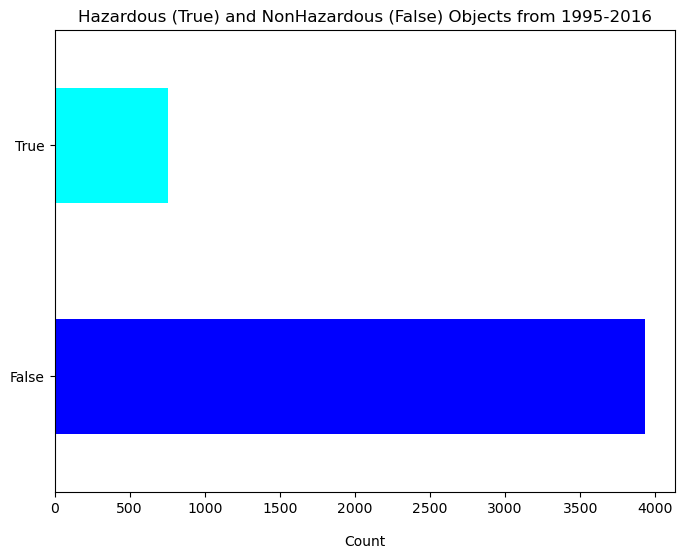

In [45]:
#plotting hazardous vs nonhazardous
color = ['blue', 'cyan']
cleaned_nasa_df['Hazardous'].value_counts().plot(kind='barh', figsize=(8, 6), color = color)
plt.xlabel("Count", labelpad=14)
plt.title("Hazardous (True) and NonHazardous (False) Objects from 1995-2016")
plt.show()

# Results - Part 3

**Topic 3** - What Potentially Hazardous Objects (PHOs) look like graphically

**Hypothesis 3** - The Semi-Major axis of a Potentially Hazardous Object (PHO) should decrease as it approaches the Sun and it's Orbital Speed (or Mean Motion) should increase as it approaches the Sun

---------------------------------------------------------------------------------------------------------------------------

Let's understand PHOs in a graphical sense by studying their parameters. The variables I will use are

* Mean Motion (units of $n$)
    * Mean Motion (where the units are defined as $n=\frac{2 \pi}{P}$, and $P$ is the orbital period) is the angular speed required for a body to complete one orbit, assuming constant speed in a circular orbit which completes in the same time as the variable speed, elliptical orbit of the actual body.
* Semi Major Axis (units of $AU$) 
    * Semi Major Axis (where 1 AU is 150 million kilometers) is half of the longest diameter of an ellipse (orbit).
* Inclination (units of degrees $\circ$)
    * Inclination, $i = \arccos \frac{h_z}{|h|}$, is computed from the orbital momentum vector $h$ and $h_z$ is the z-component of $h$. Orbital inclination measures the tilt of an object's orbit around a celestial body. It is expressed as the angle between a reference plane and the orbital plane or axis of direction of the orbiting object.

---------------------------------------------------------------------------------------------------------------------------

**Results - Part 3**

My hypothesis was correct

* Hazardous Comet - Mean Motion vs. Semi Major Axis
    * There is a decreasing trend. The Mean Motion increases as the Semi Major Axis decreases, meaning the cometary object must be speading up in its orbit and moving towards the Sun. Becasue it's moving closer to the Sun, it must be crossing the orbital paths of the inner planets. The smallest Semi Major Axis is within the range of around 2 AU, meanining it definitely crosses Earth's orbit at least once.
    
* Hazardous Asteroid - Mean Motion vs. Semi Major Axis
    * There is a decreasing trend. The Mean Motion increases as the Semi Major Axis decreases, meaning the asteroidal object must be speading up in its orbit and moving towards the Sun. Becasue it's moving closer to the Sun, it must be crossing the orbital paths of the inner planets. The smallest Semi Major Axis is within the range of around 2 AU, meanining it definitely crosses Earth's orbit at least once. There are also significantly more data points within this 2 AU range.
    
* Hazardous Comet - Semi-Major Axis vs. Inclination and Table
    * Earth's inclination is 23.4 degrees. Looking at this graph, it looks like 3 comets cross Earth's obital plane. We can look at the table to prove this.
    * From the table, there are 2 instances of comets passing Earth's plane. One is in April 1999 and the other is in February 2010. 
    
* Hazardous Asteroid - Semi-Major Axis vs. Inclination and Table
    * Earth's inclination is 23.4 degrees. There are multiple asteroids that cross Earth's orbital path in this graph. All of their Semi-Major Axes are less that 3 AU. We can look at the table to prove this.
    * From the table, there are 36 instances of asteroids crossing Earth's orbital path. From the years 1995 to 2016, there are only 4 years with no asteroid passings. That is 1999, 2004, 2008, and 2016. Every other year there is at least 1 asteroid passing. For the year 1999, though there was no asteroid crossings, there was a comet crossing. Therefore, we can infer that from 1995 to 2016, Earth experienced no asteroid or comets crossing in the years 2004, 2008, and 2016.

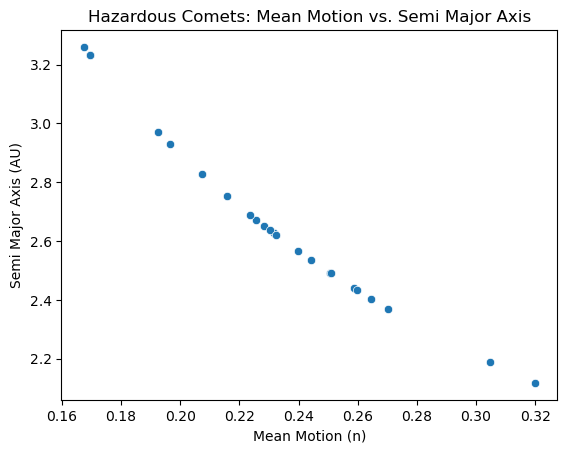

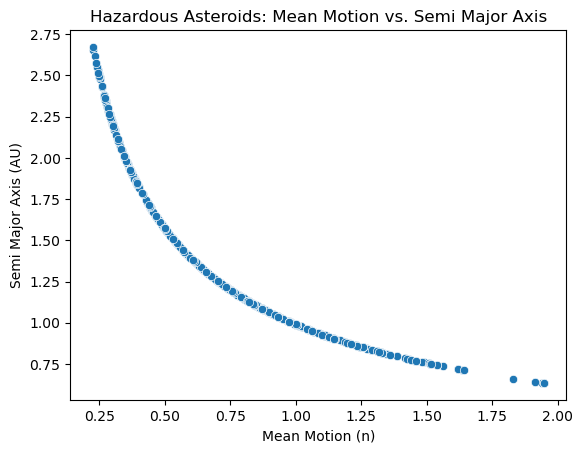

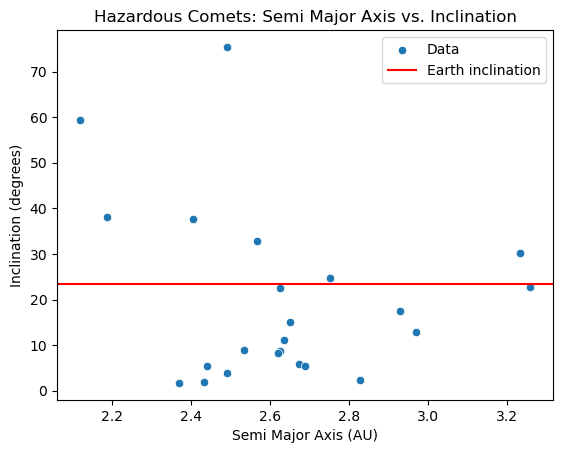

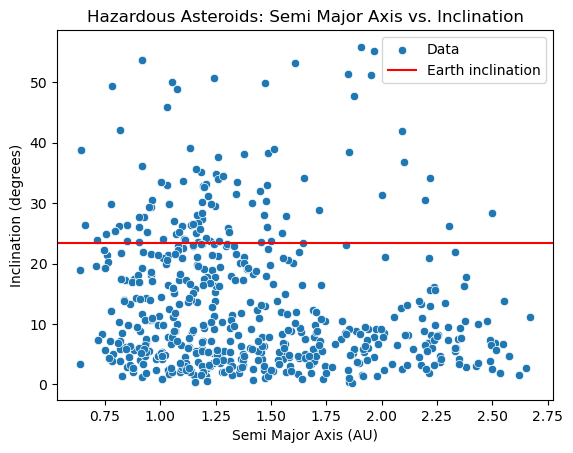

In [46]:
#comet mean motion vs. semi major axis
sns.scatterplot(data=hazardous_comets_df, x="Mean Motion", y="Semi Major Axis")
plt.xlabel('Mean Motion (n)')
plt.ylabel('Semi Major Axis (AU)')
plt.title('Hazardous Comets: Mean Motion vs. Semi Major Axis')
plt.show()

#asteroid mean motion vs. semi major axis
sns.scatterplot(data=hazardous_asteroids_df, x="Mean Motion", y="Semi Major Axis")
plt.xlabel('Mean Motion (n)')
plt.ylabel('Semi Major Axis (AU)')
plt.title('Hazardous Asteroids: Mean Motion vs. Semi Major Axis')
plt.show()

############################################################################################################################

#comet semi major axis vs. inclination
sns.scatterplot(data=hazardous_comets_df, x="Semi Major Axis", y="Inclination",label='Data')
plt.axhline(y=23.4,label='Earth inclination', color='r', linestyle='-') #Earth inclination at 23.4 degrees
plt.legend()
plt.xlabel('Semi Major Axis (AU)')
plt.ylabel('Inclination (degrees)')
plt.title('Hazardous Comets: Semi Major Axis vs. Inclination')
plt.show()

#asteroid semi major axis vs. inclination
sns.scatterplot(data=hazardous_asteroids_df, x="Semi Major Axis", y="Inclination",label='Data')
plt.axhline(y=23.4, label='Earth inclination',color='r', linestyle='-') #Earth inclination at 23.4 degrees
plt.legend()
plt.xlabel('Semi Major Axis (AU)')
plt.ylabel('Inclination (degrees)')
plt.title('Hazardous Asteroids: Semi Major Axis vs. Inclination')
plt.show()

In [47]:
#asteroids crossing Earths path
asteroids_earth_path_df = hazardous_asteroids_df[hazardous_asteroids_df['Inclination'].between(22.000000, 24.000000)]
asteroids_earth_path_df.reset_index(inplace = True,drop = True)
incc_semi_mean_asteroids_df = asteroids_earth_path_df[["Inclination","Semi Major Axis","Close Approach Date","Mean Motion"]]
display(incc_semi_mean_asteroids_df) #only 36 cross paths - only 4 years with no asteroid passing

#comets crossing Earths path
comets_earth_path_df = hazardous_comets_df[hazardous_comets_df['Inclination'].between(22.000000, 24.000000)]
comets_earth_path_df.reset_index(inplace = True,drop = True)
incc_semi_mean_comets_df = comets_earth_path_df[["Inclination","Semi Major Axis","Close Approach Date","Mean Motion"]]
display(incc_semi_mean_comets_df) #only 2 cross paths

,Inclination,Semi Major Axis,Close Approach Date,Mean Motion
0,23.766741,1.225054,1995-03-22,0.726894
1,23.277205,1.182149,1995-04-22,0.766824
2,23.861945,0.714212,1996-01-22,1.632913
3,22.858798,1.145920,1996-11-08,0.803475
4,22.503754,1.103617,1997-03-22,0.850113
5,23.309957,1.190598,1997-05-22,0.758676
6,23.745884,0.850927,1998-11-22,1.255642
7,23.746184,0.850943,1998-11-22,1.255605
8,23.277205,1.182149,2000-07-08,0.766824
9,23.897140,1.110193,2001-09-15,0.842570


,Inclination,Semi Major Axis,Close Approach Date,Mean Motion
0,22.456259,2.626090,1999-04-15,0.231601
1,22.659883,3.259846,2010-02-08,0.167459


In [48]:
#3d plot of asteroids crossing earths path
import plotly.express as px
fig = px.scatter_3d(incc_semi_mean_asteroids_df, 
                    x='Inclination', y='Semi Major Axis', z='Mean Motion') #,
              #color='species')
fig.show()

In [49]:
#3d plot of comets crossing earths path
fig = px.scatter_3d(incc_semi_mean_comets_df, 
                    x='Inclination', y='Semi Major Axis', z='Mean Motion') #,
              #color='species')
fig.show()

# Results - Part 4

**Topic 4** - What seasons does Earth experience the most Potentially Hazardous Objects (PHO) interactions

**Hypothesis 4** - Earth will experience the most Potentially Hazardous Object (PHO) interactions in the Fall months

---------------------------------------------------------------------------------------------------------------------------

Now Let's focus on the 2 new datasets from the last round of results: hazardous_asteroids_df and hazardous_comets_df. These are significantly smaller than the original and cleaned dataset I started off with.

**Months for Seasons in North America**

According to the meteorological definition, the seasons begin on the first day of the months that include the equinoxes and solstices.

* Winter - months labeled [12,1,2]
* Spring - months labeled [3,4,5]
* Summer - months labeled [6,7,8]
* Fall - months labeled [9,10,11]

This part will prove the most challenging because python reads the Close Approach Date column as an object. It will need to be converted into a different type of object that can be identified in a pie chart. For this step, I use a defined function and apply the lambda function method.

---------------------------------------------------------------------------------------------------------------------------

**Results - Part 4**

My hypothesis was incorrect, which I am actually grateful for because I was able to disprove myself
* Hazardous Asteroid Close Approach Month
    * Summer - 26.81%, Winter - 27.36%, Autumn - 22.57%, Spring - 23.36%
    * Out of 731 instances, Earth experienced the most asteroid PHOs in Winter
* Hazardous Comet Close Approach Month
    * Summer - 29.17%, Winter - 20.83%, Autumn - 29.17%, Spring - 20.83%
    * Out of 24 instances, Earth experienced the most comet PHOs in Summer and Autumn

In [50]:
def seasons(x):
    if x in [12,1,2]:
        return 'Winter'
    elif x in [3,4,5]:
        return 'Spring'
    elif x in [6,7,8]:
        return 'Summer'
    else:
        return 'Autumn'
    
hazardous_asteroids_date = pd.to_datetime(hazardous_asteroids_df['Close Approach Date']).dt.month.apply(lambda x: seasons(x))
hazardous_asteroids_date_df = hazardous_asteroids_df.assign(CloseApproachMonth = hazardous_asteroids_date)
display(hazardous_asteroids_date_df)

hazardous_comets_date = pd.to_datetime(hazardous_comets_df['Close Approach Date']).dt.month.apply(lambda x: seasons(x))
hazardous_comets_date_df = hazardous_comets_df.assign(CloseApproachMonth = hazardous_comets_date)
display(hazardous_comets_date_df)

,Absolute Magnitude,Est Dia in KM(max),Close Approach Date,Relative Velocity km per hr,Miss Dist.(Astronomical),Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Mean Anomaly,Mean Motion,Hazardous,CloseApproachMonth
0,21.6,0.284472,1995-01-01,22017.003799,0.419483,4.634,2458000.5,0.425549,1.407011,6.025981,314.373913,609.599786,0.808259,57.257470,2.005764,264.837533,0.590551,True,Winter
1,20.3,0.517654,1995-01-08,27326.560182,0.050956,4.557,2458000.5,0.348248,1.458824,4.237961,259.475979,643.580228,0.950791,248.415038,1.966857,292.893654,0.559371,True,Winter
2,21.6,0.284472,1995-01-15,35426.991794,0.407832,5.154,2458000.5,0.210448,1.225615,16.793382,84.629307,495.597821,0.967687,158.263596,1.483543,135.142133,0.726395,True,Winter
3,21.5,0.297879,1995-01-22,46438.594999,0.151806,6.623,2458000.5,0.551389,0.876125,2.059577,2.613682,299.535161,0.393040,253.765937,1.359211,119.861382,1.201862,True,Winter
4,21.7,0.271669,1995-02-22,102308.235340,0.048541,6.152,2453548.5,0.868419,0.906734,4.035074,342.784208,315.368341,0.119309,322.390496,1.694158,303.979299,1.141522,True,Winter
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
726,19.3,0.820427,2016-08-08,83037.453644,0.058309,3.921,2458000.5,0.574790,1.647586,34.116306,138.565536,772.450559,0.700571,100.270236,2.594602,205.762131,0.466049,True,Summer
727,21.5,0.297879,2016-08-08,53116.160437,0.120808,5.786,2458000.5,0.095001,1.037464,29.922212,136.762870,385.973723,0.938903,39.290250,1.136024,142.264753,0.932706,True,Summer
728,20.2,0.542051,2016-08-15,45440.631184,0.189567,4.304,2458000.5,0.376807,1.573764,11.682160,169.500723,721.120395,0.980758,196.948416,2.166770,177.326778,0.499223,True,Summer
729,21.6,0.284472,2016-08-15,61757.130145,0.390278,4.478,2458000.5,0.562406,1.439534,7.159010,54.443592,630.857755,0.629932,256.055109,2.249136,223.131665,0.570652,True,Summer


,Absolute Magnitude,Est Dia in KM(max),Close Approach Date,Relative Velocity km per hr,Miss Dist.(Astronomical),Jupiter Tisserand Invariant,Epoch Osculation,Eccentricity,Semi Major Axis,Inclination,Asc Node Longitude,Orbital Period,Perihelion Distance,Perihelion Arg,Aphelion Dist,Mean Anomaly,Mean Motion,Hazardous,CloseApproachMonth
0,21.2,0.342011,1995-09-22,118849.444447,0.428792,2.976,2458000.5,0.742920,2.535083,8.947768,344.161592,1474.303194,0.651720,118.259534,4.418447,149.774654,0.244183,True,Autumn
1,18.3,1.300289,1996-06-08,79002.171980,0.191414,2.962,2458000.5,0.702387,2.672460,5.852198,13.860048,1595.751020,0.795358,319.815769,4.549561,314.107896,0.225599,True,Summer
2,21.1,0.358129,1996-08-08,92787.819344,0.046488,2.753,2458000.5,0.819252,2.651713,15.020224,126.778872,1577.204947,0.479292,289.259931,4.824133,310.976922,0.228252,True,Summer
3,21.3,0.326618,1999-04-15,91730.526338,0.215250,2.933,2458000.5,0.688874,2.626090,22.456259,35.969525,1554.400365,0.817044,238.326758,4.435136,105.998114,0.231601,True,Spring
4,18.0,1.492932,1999-04-22,131337.227262,0.047900,2.943,2458000.5,0.664500,2.117351,59.379202,33.605726,1125.349950,0.710371,251.101810,3.524330,333.457793,0.319900,True,Spring
5,20.4,0.494356,1999-07-22,97634.768489,0.308697,2.968,2458000.5,0.712265,2.625573,8.621482,285.551518,1553.941552,0.755470,287.321323,4.495677,102.641980,0.231669,True,Summer
6,19.3,0.820427,2001-01-15,82764.190415,0.290819,2.978,2458000.5,0.654553,2.404100,37.683934,133.042396,1361.530328,0.830490,316.324510,3.977711,173.047863,0.264408,True,Winter
7,21.1,0.358129,2001-07-08,64035.769781,0.359285,2.907,2458000.5,0.744335,2.635714,11.016894,178.028592,1562.952416,0.673859,92.292936,4.597568,277.717287,0.230333,True,Summer
8,19.4,0.783502,2002-05-15,81913.831050,0.145828,2.607,2458000.5,0.681327,3.234045,30.108839,144.876011,2124.308533,1.030602,174.416280,5.437489,345.162724,0.169467,True,Spring
9,19.0,0.941976,2003-12-22,128314.039921,0.381349,2.732,2458000.5,0.770621,2.752302,24.819218,286.212490,1667.794600,0.631319,262.270689,4.873285,350.868981,0.215854,True,Winter


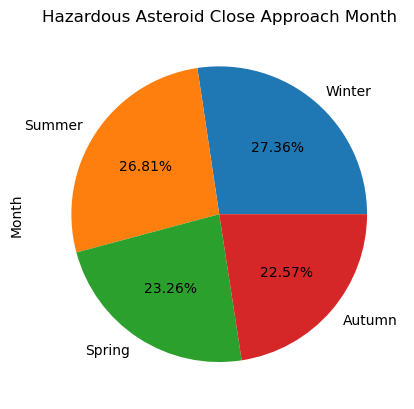

In [51]:
hazardous_asteroids_date_df.CloseApproachMonth.value_counts().plot(kind='pie', ylabel='Month', title='Hazardous Asteroid Close Approach Month', autopct='%.2f%%')
plt.show()

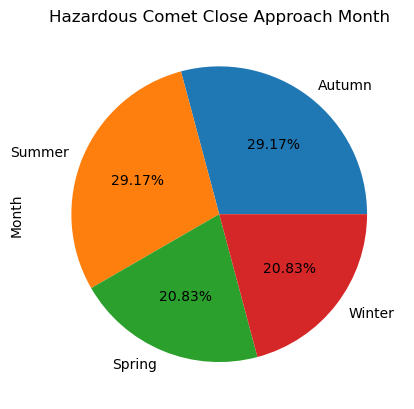

In [52]:
hazardous_comets_date_df.CloseApproachMonth.value_counts().plot(kind='pie',ylabel='Month', title='Hazardous Comet Close Approach Month', autopct='%.2f%%')
plt.show()